<a href="https://colab.research.google.com/github/andrewdepriest/earthquake-tectonic/blob/main/Seismic_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [25]:
#libraries
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium import Choropleth
from folium.plugins import HeatMap
import datetime

np.random.seed(0)

In [26]:
#loading first dataset
df = pd.read_csv('earthquakes.csv')
df.head()

,Date,Time,Latitude,Longitude,Type,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Type,...,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square,ID,Source,Location Source,Magnitude Source,Status
0,01/02/1965,13:44:18,19.246,145.616,Earthquake,131.6,NaN,NaN,6.0,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic
1,01/04/1965,11:29:49,1.863,127.352,Earthquake,80.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic
2,01/05/1965,18:05:58,-20.579,-173.972,Earthquake,20.0,NaN,NaN,6.2,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic
3,01/08/1965,18:49:43,-59.076,-23.557,Earthquake,15.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic
4,01/09/1965,13:32:50,11.938,126.427,Earthquake,15.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic


In [27]:
#dropping columns with missing values
missing_val_columns = [col for col in df.columns
                     if df[col].isnull().any()]
df = df.drop(missing_val_columns, axis=1)
df.head()

,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,ID,Source,Location Source,Magnitude Source,Status
0,01/02/1965,13:44:18,19.246,145.616,Earthquake,131.6,6.0,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic
1,01/04/1965,11:29:49,1.863,127.352,Earthquake,80.0,5.8,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic
2,01/05/1965,18:05:58,-20.579,-173.972,Earthquake,20.0,6.2,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic
3,01/08/1965,18:49:43,-59.076,-23.557,Earthquake,15.0,5.8,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic
4,01/09/1965,13:32:50,11.938,126.427,Earthquake,15.0,5.8,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic


In [28]:
#loading second dataset
tectonic_plates = pd.read_csv('tectonic_plates.csv')
tectonic_plates.head()

,plate,lat,lon
0,am,30.754,132.824
1,am,30.970,132.965
2,am,31.216,133.197
3,am,31.515,133.500
4,am,31.882,134.042


In [29]:
#data cleaning

In [30]:
#parsing datetime, finding lengths
lengths = df['Date'].str.len()
lengths.value_counts()

10    23409
24        3
Name: Date, dtype: int64

In [31]:
#looking at wrong date data points
false_dates = np.where([lengths==24])[1]
print(false_dates)
df.loc[false_dates]

[ 3378  7512 20650]


,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,ID,Source,Location Source,Magnitude Source,Status
3378,1975-02-23T02:58:41.000Z,1975-02-23T02:58:41.000Z,8.017,124.075,Earthquake,623.0,5.6,USP0000A09,US,US,US,Reviewed
7512,1985-04-28T02:53:41.530Z,1985-04-28T02:53:41.530Z,-32.998,-71.766,Earthquake,33.0,5.6,USP0002E81,US,US,HRV,Reviewed
20650,2011-03-13T02:23:34.520Z,2011-03-13T02:23:34.520Z,36.344,142.344,Earthquake,10.1,5.8,USP000HWQP,US,US,GCMT,Reviewed


In [32]:
#fixing the false datetimes
df.loc[3378, 'Date'] = '02/23/1975'
df.loc[7512, 'Date'] = '04/28/1985'
df.loc[20650, 'Date'] = '03/13/2011'

#changing to recognized datetime by python
df['Date']= pd.to_datetime(df['Date'])
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23412 entries, 0 to 23411
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Date              23412 non-null  datetime64[ns]
 1   Time              23412 non-null  object        
 2   Latitude          23412 non-null  float64       
 3   Longitude         23412 non-null  float64       
 4   Type              23412 non-null  object        
 5   Depth             23412 non-null  float64       
 6   Magnitude         23412 non-null  float64       
 7   ID                23412 non-null  object        
 8   Source            23412 non-null  object        
 9   Location Source   23412 non-null  object        
 10  Magnitude Source  23412 non-null  object        
 11  Status            23412 non-null  object        
dtypes: datetime64[ns](1), float64(4), object(7)
memory usage: 2.1+ MB


In [33]:
#same cleaning for 'Time'
lengths = df['Time'].str.len()
lengths.value_counts()

8     23409
24        3
Name: Time, dtype: int64

In [34]:
#looking at wrong time data points
false_times = np.where([lengths==24])[1]
print(false_times)
df.loc[false_times]

[ 3378  7512 20650]


,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,ID,Source,Location Source,Magnitude Source,Status
3378,1975-02-23,1975-02-23T02:58:41.000Z,8.017,124.075,Earthquake,623.0,5.6,USP0000A09,US,US,US,Reviewed
7512,1985-04-28,1985-04-28T02:53:41.530Z,-32.998,-71.766,Earthquake,33.0,5.6,USP0002E81,US,US,HRV,Reviewed
20650,2011-03-13,2011-03-13T02:23:34.520Z,36.344,142.344,Earthquake,10.1,5.8,USP000HWQP,US,US,GCMT,Reviewed


In [35]:
#fixing times and setting it to timedelta
df.loc[3378, 'Time'] = '02:58:41'
df.loc[7512, 'Time'] = '02:53:41'
df.loc[20650, 'Time'] = '02:23:34'

df['Time'] = df['Time'].str.replace('^-', '')
df['Time'] = pd.to_timedelta(df['Time'])
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23412 entries, 0 to 23411
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype          
---  ------            --------------  -----          
 0   Date              23412 non-null  datetime64[ns] 
 1   Time              23412 non-null  timedelta64[ns]
 2   Latitude          23412 non-null  float64        
 3   Longitude         23412 non-null  float64        
 4   Type              23412 non-null  object         
 5   Depth             23412 non-null  float64        
 6   Magnitude         23412 non-null  float64        
 7   ID                23412 non-null  object         
 8   Source            23412 non-null  object         
 9   Location Source   23412 non-null  object         
 10  Magnitude Source  23412 non-null  object         
 11  Status            23412 non-null  object         
dtypes: datetime64[ns](1), float64(4), object(6), timedelta64[ns](1)
memory usage: 2.1+ MB


<ipython-input-35-3773182b0a59>:6: FutureWarning: The default value of regex will change from True to False in a future version.
  df['Time'] = df['Time'].str.replace('^-', '')


In [36]:
#creating additional time data
df['Date_Time'] = df['Date'] + df['Time']
df['Days']= df.Date.dt.strftime('%A')
df.head()

,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,ID,Source,Location Source,Magnitude Source,Status,Date_Time,Days
0,1965-01-02,0 days 13:44:18,19.246,145.616,Earthquake,131.6,6.0,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic,1965-01-02 13:44:18,Saturday
1,1965-01-04,0 days 11:29:49,1.863,127.352,Earthquake,80.0,5.8,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic,1965-01-04 11:29:49,Monday
2,1965-01-05,0 days 18:05:58,-20.579,-173.972,Earthquake,20.0,6.2,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic,1965-01-05 18:05:58,Tuesday
3,1965-01-08,0 days 18:49:43,-59.076,-23.557,Earthquake,15.0,5.8,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic,1965-01-08 18:49:43,Friday
4,1965-01-09,0 days 13:32:50,11.938,126.427,Earthquake,15.0,5.8,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic,1965-01-09 13:32:50,Saturday


In [37]:
#data analysis

Text(0.5, 0, 'Date')

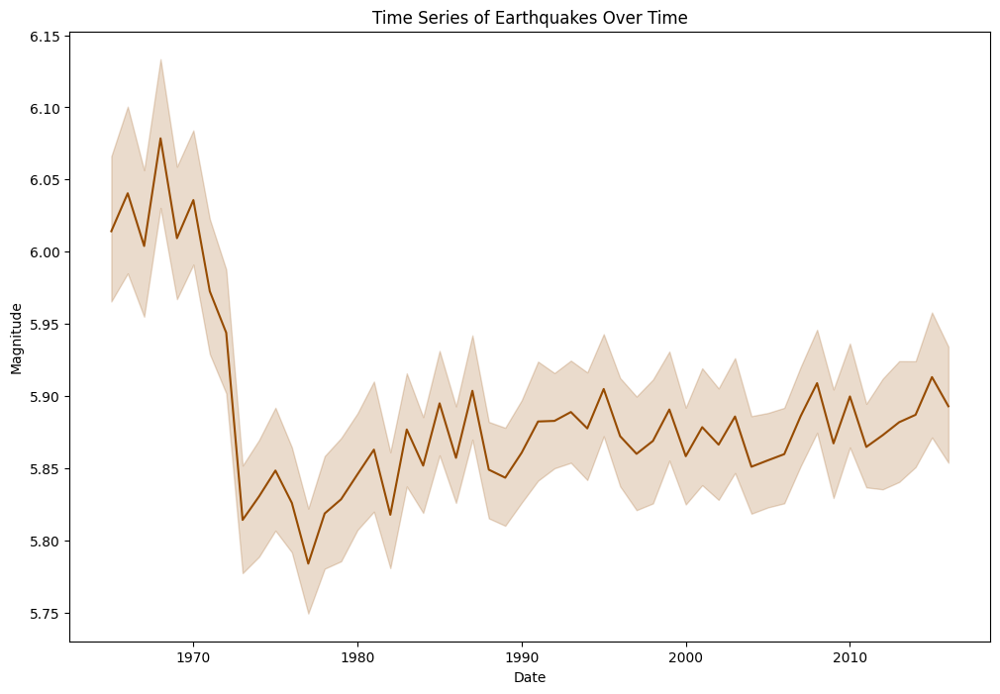

In [38]:
#lineplot with magnitues over time
plt.figure(figsize=(12,8))
Time_series = sns.lineplot(x=df['Date'].dt.year, y='Magnitude', data=df, color='#964B00')
Time_series.set_title('Time Series of Earthquakes Over Time')
Time_series.set_ylabel("Magnitude")
Time_series.set_xlabel("Date")


Text(0.5, 0, 'Date')

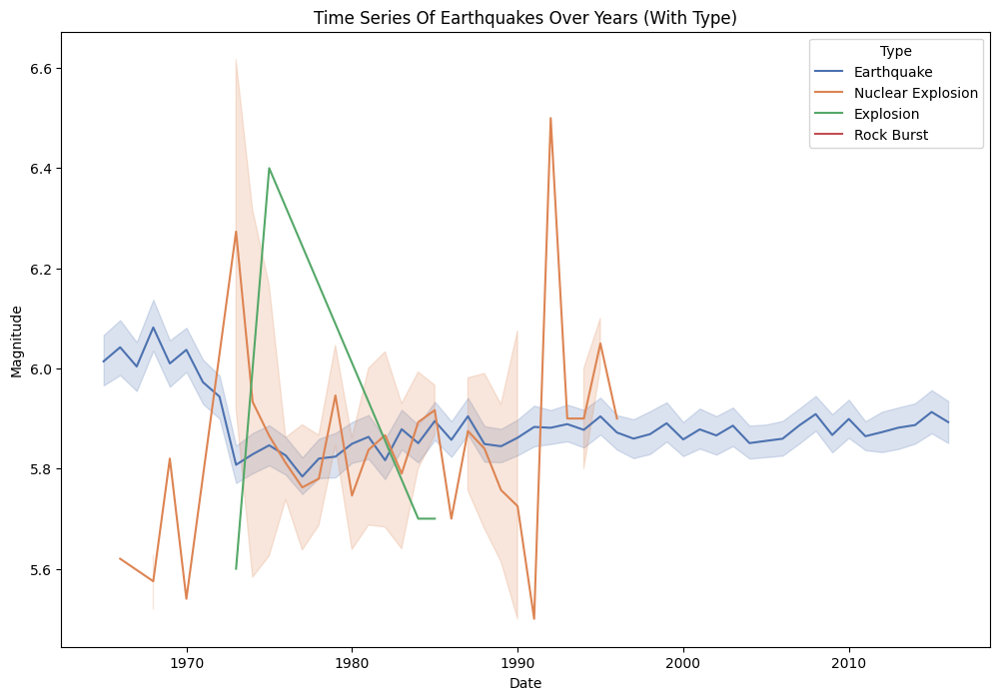

In [39]:
plt.figure(figsize=(12,8))
Time_series_Type = sns.lineplot(x=df['Date'].dt.year, y='Magnitude', data=df,\
                                palette='deep', hue='Type')
Time_series_Type.set_title("Time Series Of Earthquakes Over Years (With Type)")
Time_series_Type.set_ylabel("Magnitude")
Time_series_Type.set_xlabel("Date")

<ipython-input-40-bc9bc850b742>:3: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  Days_of_week=sns.barplot(x=df['Days'], y='Magnitude', data=df\


Text(0.5, 0, 'Days of Week')

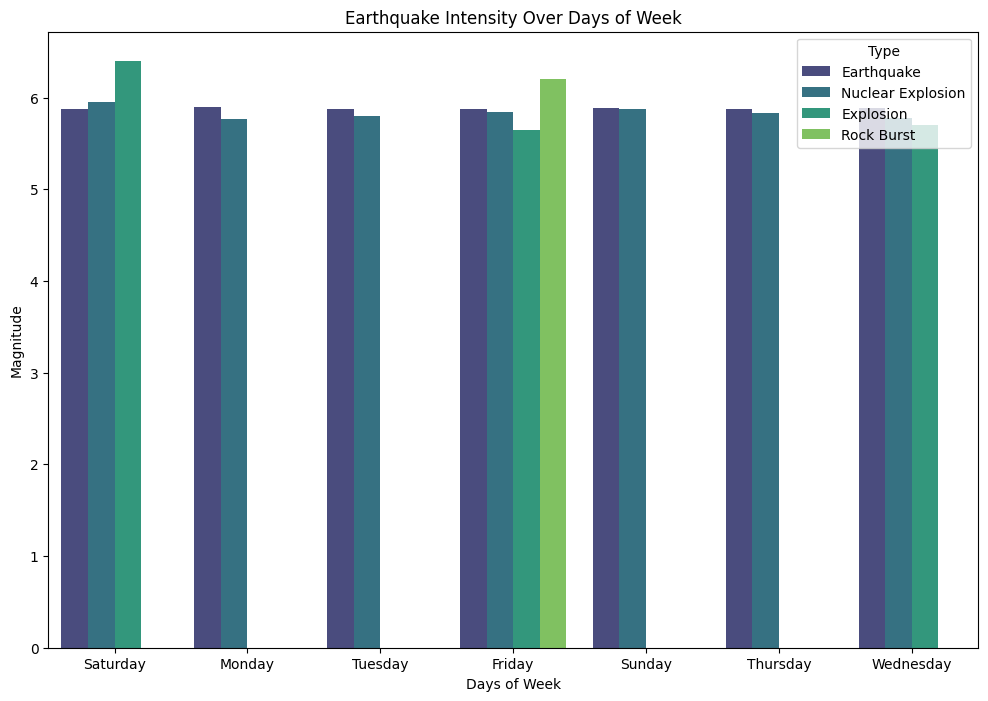

In [40]:
#distribution of earthquakes across days of week
plt.figure(figsize=(12,8))
Days_of_week=sns.barplot(x=df['Days'], y='Magnitude', data=df\
                         , hue='Type', palette='viridis', ci=None)
Days_of_week.set_title('Earthquake Intensity Over Days of Week')
Days_of_week.set_ylabel('Magnitude')
Days_of_week.set_xlabel('Days of Week')

In [41]:
#geospatial mapping

In [42]:
# #displaying the plates on a map
# tectonic = folium.Map(tiles='cartodbpositron', zoom_start=5)
# plates = list(tectonic_plates['plate'].unique())
# for plate in plates:
#   plate_vals = tectonic_plates[tectonic_plates['plate'] == plate]
#   lats = plate_vals['lat'].values
#   lons = plate_vals['lon'].values
#   points = list(zip(lats,lons))
#   indexes = [None] + [i + 1 for i, x in enumerate(points)\
#                       if i < len(points) - 1 and abs(x[1]\
#                       - points[i + 1][1]) > 300] + [None]
#   for i in range(len(indexes) - 1):
#     folium.vector_layers.PolyLine(points[indexes[i]:indexes[i+1]],\
#                                   popup=plate, color='#58508d', \
#                                   fill=False).add_to(tectonic)
# tectonic

In [43]:
# #displaying plates along with earthquakes
# tectonic_quake = folium.Map(tiles="cartodbpositron", zoom_start=5)
# gradient = {.33: '#7a5195', .66: '#ef5675', 1: '#ffa600'}
# plates = list(tectonic_plates['plate'].unique())
# for plate in plates:
#     plate_vals = tectonic_plates[tectonic_plates['plate'] == plate]
#     lats = plate_vals['lat'].values
#     lons = plate_vals['lon'].values
#     points = list(zip(lats, lons))
#     indexes = [None] + [i + 1 for i, x in enumerate(points)\
#                         if i < len(points) - 1 and abs(x[1] \
#                         - points[i + 1][1]) > 300] + [None]
#     for i in range(len(indexes) - 1):
#         folium.vector_layers.PolyLine(points[indexes[i]:indexes[i+1]],\
#         popup=plate, fill=False,  color="#58508d").add_to(tectonic_quake)
#         HeatMap(data=df[['Latitude','Longitude']], hues='Magnitude', \
#                 min_opacity=0.5, radius=1, gradient=gradient).add_to(tectonic_quake)
# tectonic_quake

In [44]:
# #same as before but with only earthquakes and no other 'Type'
# tectonic_quake = folium.Map(tiles="cartodbpositron", zoom_start=5)
# plates = list(tectonic_plates['plate'].unique())
# for plate in plates:
#     plate_vals = tectonic_plates[tectonic_plates["plate"] == plate]
#     lats = plate_vals["lat"].values
#     lons = plate_vals["lon"].values
#     points = list(zip(lats, lons))
#     indexes = [None] + [i + 1 for i, x in enumerate(points) if i < len(points) - 1 and abs(x[1] - points[i + 1][1]) > 300] + [None]
#     for i in range(len(indexes) - 1):
#         df_onlyquakes = df[df['Type'] == 'Earthquake']
#         folium.vector_layers.PolyLine(points[indexes[i]:indexes[i+1]], popup=plate, fill=False,  color="#58508d").add_to(tectonic_quake)
#         HeatMap(data=df_onlyquakes[["Latitude", "Longitude"]], min_opacity=0.5,max_zoom=40,max_val=0.5,radius=1,gradient=gradient).add_to(tectonic_quake)

# tectonic_quake

In [45]:
#map with boundaries and magnitude
magnitude_tectonics = folium.Map(tiles='cartodbpositron', zoom_start=5)
gradient = {.33: "#628d82", .66: "#a3c5bf", 1: "#eafffd"}
plates = list(tectonic_plates["plate"].unique())
for plate in plates:
    plate_vals = tectonic_plates[tectonic_plates["plate"] == plate]
    lats = plate_vals["lat"].values
    lons = plate_vals["lon"].values
    points = list(zip(lats, lons))
    indexes = [None] + [i + 1 for i, x in enumerate(points) if i < len(points)\
                        - 1 and abs(x[1] - points[i + 1][1]) > 300] + [None]
    for i in range(len(indexes) - 1):
        folium.vector_layers.PolyLine(points[indexes[i]:indexes[i+1]], fill=False,\
                                      color="#58508d").add_to(magnitude_tectonics)

def color_magnitude(val):
  if val < 5.9:
      return "#ffeda0"
  elif val < 6.5:
      return "#f46d43"
  else:
      return "#67001f"

for i in range(0, len(df)):
  folium.Circle(location=[df.iloc[i]["Latitude"], df.iloc[i]["Longitude"]],\
                radius=2000, color=color_magnitude(df.iloc[i]["Magnitude"])).add_to(magnitude_tectonics)

legend_html = '''
     <div style="position: fixed; bottom: 50px; left: 50px; z-index:9999; font-size: 14px;">
     <p>Magnitude Legend</p>
     <p><span style="color:#ffeda0">&#9679;</span> Magnitude &lt; 5.9</p>
     <p><span style="color:#f46d43">&#9679;</span> 5.9 &le; Magnitude &lt; 6.5</p>
     <p><span style="color:#67001f">&#9679;</span> Magnitude &ge; 6.5</p>
     </div>
     '''
magnitude_tectonics.get_root().html.add_child(folium.Element(legend_html))

folium.LayerControl().add_to(magnitude_tectonics)

magnitude_tectonics

In [46]:
#map with boundaries and depth
depth_tectonics  = folium.Map(tiles="cartodbpositron", zoom_start=5)
gradient = {.33: "#628d82", .66: "#a3c5bf", 1: "#eafffd"}
plates = list(tectonic_plates["plate"].unique())
for plate in plates:
    plate_vals = tectonic_plates[tectonic_plates["plate"] == plate]
    lats = plate_vals["lat"].values
    lons = plate_vals["lon"].values
    points = list(zip(lats, lons))
    indexes = [None] + [i + 1 for i, x in enumerate(points) if i < len(points) -\
                        1 and abs(x[1] - points[i + 1][1]) > 300] + [None]
    for i in range(len(indexes) - 1):
        folium.vector_layers.PolyLine(points[indexes[i]:indexes[i+1]],fill=False,\
                                      color="#58508d").add_to(depth_tectonics)

def color_depth(val):
            if val < 50.0:
                return "#ffeda0"
            elif val < 100.0:
                return "#f46d43"
            else:
                return "#67001f"

for i in range(0,len(df)):
    folium.Circle(location=[df.iloc[i]["Latitude"], df.iloc[i]["Longitude"]],radius=2000,\
                  color=color_depth(df.iloc[i]["Depth"])).add_to(depth_tectonics)

legend_html = '''
     <div style="position: fixed; bottom: 50px; left: 50px; z-index:9999; font-size: 14px;">
     <p>Depth Legend</p>
     <p><span style="color:#ffeda0">&#9679;</span> Depth &lt; 50.0</p>
     <p><span style="color:#f46d43">&#9679;</span> 50.0 &le; Depth &lt; 100.0</p>
     <p><span style="color:#67001f">&#9679;</span> Depth &ge; 100.0</p>
     </div>
     '''
depth_tectonics.get_root().html.add_child(folium.Element(legend_html))

folium.LayerControl().add_to(depth_tectonics)

depth_tectonics

In [47]:
pip install selenium

In [48]:
import io
from PIL import Image

img_data = depth_tectonics._to_png(5)
img = Image.open(io.BytesIO(img_data))
img.save('depth_tectonics.png')